=== SMART METER DATA RESAMPLING & ANALYSIS ===
Tanggal eksekusi: 2025-07-16 12:51:02
=== LOADING DATA ===
Data berhasil dimuat: (3673260, 29)

=== VALIDASI TIMESTAMP ===
Data sebelum cleaning: 3673260 records
Rentang tahun dalam data: 2023 - 2041
Ditemukan 26 record dengan timestamp invalid:
  - Tahun < 2023: 0
  - Tahun > 2025: 26

Data setelah cleaning: 3673234 records
Records dihapus: 26
Data final setelah preprocessing: (3673234, 28)
Missing values: 22199196

=== DATA ORIGINAL (SETELAH PREPROCESSING) ===
Shape: (3673234, 28)
Periode: 2023-09-22 14:00:03 - 2025-01-30 10:50:03
Jumlah meter: 44

=== PROSES RESAMPLING ===
  Processing meter 0: 159756 records
  Available columns with data: 14
  Successfully resampled to 12433 records
  Data coverage: 64.8%
  Processing meter 251400172: 969 records
  Available columns with data: 15
  Successfully resampled to 381 records
  Data coverage: 70.5%
  Processing meter 251400177: 19090 records
  Available columns with data: 15
  Successfully re

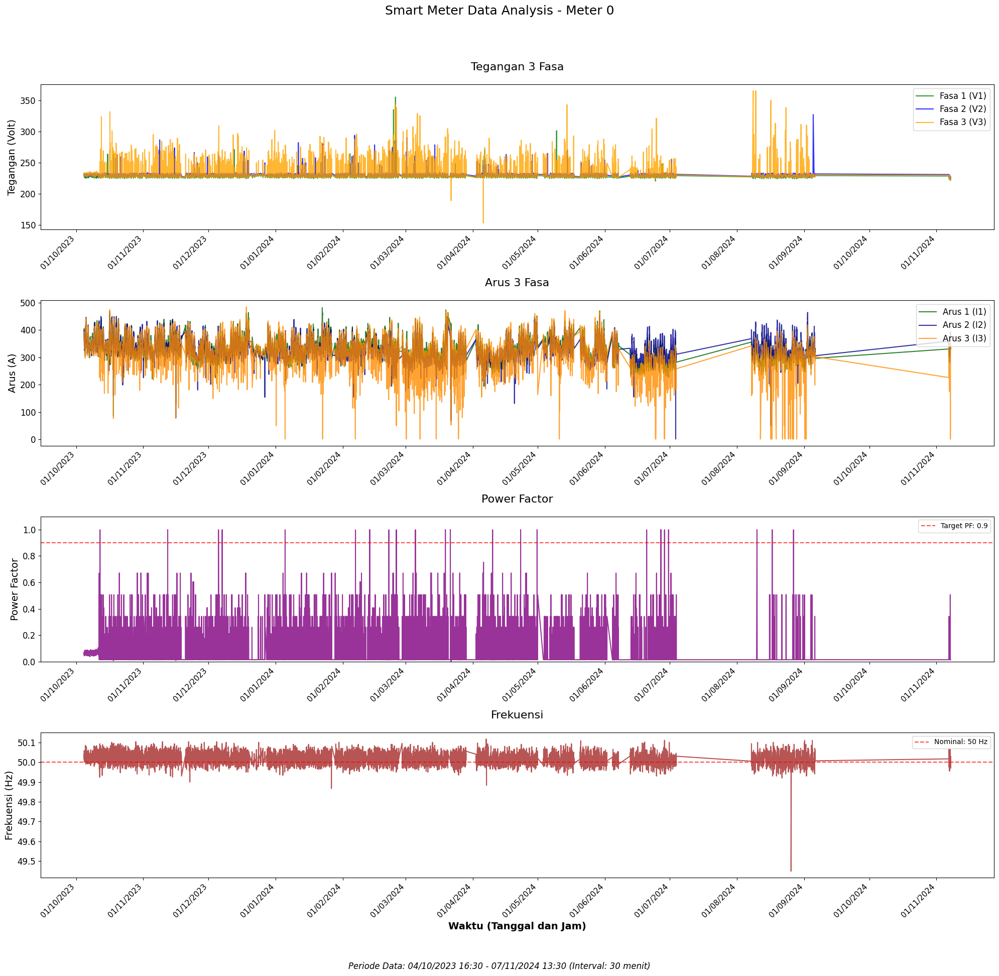

Visualisasi berhasil dibuat dengan 4 subplot aktif

=== PROSES SELESAI ===
Total meter yang berhasil diproses: 42


In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

# Set style untuk visualisasi yang lebih baik
plt.style.use('default')
plt.rcParams['figure.autolayout'] = True

def validate_and_clean_timestamps(df):
    """
    Validasi dan pembersihan timestamp yang tidak valid
    """
    print(f"\n=== VALIDASI TIMESTAMP ===")
    
    # Set rentang tahun yang valid (2023-2025)
    valid_year_start = 2023
    valid_year_end = 2025
    
    # Tampilkan info sebelum cleaning
    print(f"Data sebelum cleaning: {len(df)} records")
    print(f"Rentang tahun dalam data: {df.index.year.min()} - {df.index.year.max()}")
    
    # Identifikasi data dengan tahun yang tidak valid
    invalid_years = df[
        (df.index.year < valid_year_start) | 
        (df.index.year > valid_year_end)
    ]
    
    if not invalid_years.empty:
        print(f"Ditemukan {len(invalid_years)} record dengan timestamp invalid:")
        print(f"  - Tahun < {valid_year_start}: {len(df[df.index.year < valid_year_start])}")
        print(f"  - Tahun > {valid_year_end}: {len(df[df.index.year > valid_year_end])}")
        
        # Hapus data dengan timestamp invalid
        df_clean = df[
            (df.index.year >= valid_year_start) & 
            (df.index.year <= valid_year_end)
        ]
        
        print(f"\nData setelah cleaning: {len(df_clean)} records")
        print(f"Records dihapus: {len(df) - len(df_clean)}")
        
        return df_clean
    else:
        print("Tidak ada timestamp invalid yang ditemukan")
        return df

def detect_and_remove_gaps(data, max_gap_hours=6):
    """
    Deteksi dan hilangkan gap data yang terlalu besar
    """
    # Hitung gap antar data points
    time_diff = data.index.to_series().diff()
    
    # Identifikasi gap yang lebih besar dari threshold
    large_gaps = time_diff > pd.Timedelta(hours=max_gap_hours)
    
    # Tandai data setelah gap besar sebagai NaN untuk menghindari interpolasi yang berlebihan
    gap_mask = large_gaps.cumsum() > 0
    
    # Reset mask setelah data valid kembali muncul
    result = data.copy()
    
    # Untuk setiap kolom numerik, set NaN pada gap yang terlalu besar
    for col in result.select_dtypes(include=[np.number]).columns:
        # Temukan posisi dimana gap besar terjadi
        gap_starts = large_gaps[large_gaps].index
        
        for gap_start in gap_starts:
            # Cari data valid berikutnya
            future_data = result.loc[gap_start:, col].dropna()
            if len(future_data) > 0:
                next_valid = future_data.index[0]
                # Set NaN pada gap
                result.loc[gap_start:next_valid, col] = np.nan
    
    return result

def smart_interpolation_with_gap_handling(series, max_interpolate_points=6):
    """
    Interpolasi cerdas yang menghindari interpolasi berlebihan pada gap besar
    """
    result = series.copy()
    
    # Identifikasi consecutive NaN sequences
    is_null = result.isnull()
    null_groups = (is_null != is_null.shift()).cumsum()
    
    # Untuk setiap group NaN, cek apakah terlalu panjang untuk diinterpolasi
    for group_id in null_groups[is_null].unique():
        group_mask = (null_groups == group_id) & is_null
        group_length = group_mask.sum()
        
        if group_length <= max_interpolate_points:
            # Interpolasi gap kecil dengan linear
            result.loc[group_mask] = result.loc[group_mask].interpolate(method='linear')
        else:
            # Untuk gap besar, biarkan sebagai NaN (akan menyebabkan break dalam plot)
            continue
    
    return result

def load_and_preprocess_data(filename):
    """
    Load dan preprocess data smart meter dengan validasi yang lebih toleran
    """
    try:
        print(f"=== LOADING DATA ===")
        df = pd.read_csv(filename)
        print(f"Data berhasil dimuat: {df.shape}")
        
        # Konversi kolom id_time ke format datetime
        df['id_time'] = pd.to_datetime(df['id_time'], errors='coerce')
        
        # Hapus record dengan timestamp invalid
        df = df.dropna(subset=['id_time'])
        
        # Set id_time sebagai index
        df.set_index('id_time', inplace=True)
        
        # Urutkan data berdasarkan datetime
        df.sort_index(inplace=True)
        
        # Validasi dan bersihkan timestamp yang tidak valid (tahun 2042)
        df = validate_and_clean_timestamps(df)
        
        # Konversi kolom numerik yang mungkin bertipe object
        numeric_cols = [
            'id_stand_energy_kirim', 'id_stand_energy_terima',
            'id_v1', 'id_v2', 'id_v3', 'id_i1', 'id_i2', 'id_i3',
            'id_daya_aktif_plus', 'id_daya_aktif_minus', 'id_frequency',
            'id_power_factor', 'reactive_energy_import', 'reactive_energy_export',
            'apparent_energy_import', 'apparent_energy_export', 'rssi'
        ]
        
        for col in numeric_cols:
            if col in df.columns:
                df[col] = pd.to_numeric(df[col], errors='coerce')
        
        print(f"Data final setelah preprocessing: {df.shape}")
        print(f"Missing values: {df.isnull().sum().sum()}")
        
        return df
    
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

def resample_meter_data(meter_data, meter_id):
    """
    Resampling data dengan gap handling yang lebih baik
    """
    print(f"  Processing meter {meter_id}: {len(meter_data)} records")
    
    # Validasi periode data
    if len(meter_data) < 5:
        print(f"  Warning: Insufficient data for meter {meter_id}")
        return None
    
    # Kolom numerik yang akan di-resample
    numeric_cols = [
        'id_stand_energy_kirim', 'id_stand_energy_terima',
        'id_v1', 'id_v2', 'id_v3', 'id_i1', 'id_i2', 'id_i3',
        'id_daya_aktif_plus', 'id_daya_aktif_minus', 'id_frequency',
        'id_power_factor', 'reactive_energy_import', 'reactive_energy_export',
        'apparent_energy_import', 'apparent_energy_export', 'rssi'
    ]
    
    # Filter kolom yang ada dan memiliki data valid
    available_cols = []
    for col in numeric_cols:
        if col in meter_data.columns:
            non_null_count = meter_data[col].notna().sum()
            if non_null_count > 0:
                available_cols.append(col)
    
    if not available_cols:
        print(f"  Warning: No valid numeric columns found for meter {meter_id}")
        return None
    
    print(f"  Available columns with data: {len(available_cols)}")
    
    # Deteksi dan tangani gap besar sebelum resampling
    meter_data_cleaned = detect_and_remove_gaps(meter_data)
    
    # Ambil data numerik untuk resampling
    meter_numeric = meter_data_cleaned[available_cols]
    
    # Konfigurasi agregasi
    agg_config = {}
    energy_cols = ['id_stand_energy_kirim', 'id_stand_energy_terima', 
                   'reactive_energy_import', 'reactive_energy_export',
                   'apparent_energy_import', 'apparent_energy_export']
    
    for col in available_cols:
        if col in energy_cols:
            agg_config[col] = 'last'
        else:
            agg_config[col] = 'mean'
    
    # Resampling ke interval 30 menit
    try:
        resampled_meter = meter_numeric.resample('30min').agg(agg_config)
        
        if resampled_meter.empty:
            print(f"  Warning: Resampling resulted in empty dataframe for meter {meter_id}")
            return None
        
        # Tambahkan informasi meter_id dan lokasi
        resampled_meter['id_meter_id'] = meter_id
        if 'lokasi' in meter_data.columns:
            resampled_meter['lokasi'] = meter_data['lokasi'].iloc[0]
        
        # Interpolasi cerdas dengan gap handling
        interpolated_cols = []
        for col in available_cols:
            if resampled_meter[col].notna().sum() >= 2:
                # Gunakan smart interpolation yang menghindari gap besar
                resampled_meter[col] = smart_interpolation_with_gap_handling(
                    resampled_meter[col], max_interpolate_points=6
                )
                interpolated_cols.append(col)
        
        # Hitung coverage setelah interpolasi
        coverage = (resampled_meter[available_cols].notna().sum().sum() / 
                   (len(resampled_meter) * len(available_cols))) * 100
        
        if coverage < 20:  # Threshold yang lebih rendah
            print(f"  Warning: Low data coverage ({coverage:.1f}%) for meter {meter_id}")
            return None
        
        # Hapus baris dengan semua nilai NaN
        resampled_meter = resampled_meter.dropna(how='all', subset=available_cols)
        
        if resampled_meter.empty:
            print(f"  Warning: No data left after removing all-NaN rows for meter {meter_id}")
            return None
        
        print(f"  Successfully resampled to {len(resampled_meter)} records")
        print(f"  Data coverage: {coverage:.1f}%")
        
        return resampled_meter
        
    except Exception as e:
        print(f"  Error resampling meter {meter_id}: {e}")
        return None

def create_comprehensive_visualization(sample_data, meter_id):
    """
    Membuat visualisasi yang menghilangkan grid lines dan garis lurus
    """
    if sample_data.empty:
        print(f"Warning: No data available for visualization for meter {meter_id}")
        return
    
    # Tentukan plot mana yang memiliki data
    plot_configs = []
    
    # Cek Daya Aktif
    if 'id_daya_aktif_plus' in sample_data.columns and sample_data['id_daya_aktif_plus'].notna().sum() > 0:
        power_data = sample_data['id_daya_aktif_plus'].dropna()
        plot_configs.append({
            'type': 'power',
            'data': power_data,
            'title': 'Daya Aktif Plus',
            'ylabel': 'Daya (kW)',
            'color': 'red'
        })
    
    # Cek Tegangan
    voltage_cols = ['id_v1', 'id_v2', 'id_v3']
    available_voltage = [col for col in voltage_cols if col in sample_data.columns and sample_data[col].notna().sum() > 0]
    if available_voltage:
        voltage_data = sample_data[available_voltage].copy()
        plot_configs.append({
            'type': 'voltage',
            'data': voltage_data,
            'title': 'Tegangan 3 Fasa',
            'ylabel': 'Tegangan (Volt)',
            'colors': ['green', 'blue', 'orange'],
            'legend': ['Fasa 1 (V1)', 'Fasa 2 (V2)', 'Fasa 3 (V3)']
        })
    
    # Cek Arus
    current_cols = ['id_i1', 'id_i2', 'id_i3']
    available_current = [col for col in current_cols if col in sample_data.columns and sample_data[col].notna().sum() > 0]
    if available_current:
        current_data = sample_data[available_current].copy()
        plot_configs.append({
            'type': 'current',
            'data': current_data,
            'title': 'Arus 3 Fasa',
            'ylabel': 'Arus (A)',
            'colors': ['darkgreen', 'darkblue', 'darkorange'],
            'legend': ['Arus 1 (I1)', 'Arus 2 (I2)', 'Arus 3 (I3)']
        })
    
    # Cek Power Factor
    if 'id_power_factor' in sample_data.columns and sample_data['id_power_factor'].notna().sum() > 0:
        pf_data = sample_data['id_power_factor'].dropna()
        if pf_data.max() > 2:
            pf_data = pf_data / pf_data.max()
        plot_configs.append({
            'type': 'pf',
            'data': pf_data,
            'title': 'Power Factor',
            'ylabel': 'Power Factor',
            'color': 'purple'
        })
    
    # Cek Frequency
    if 'id_frequency' in sample_data.columns and sample_data['id_frequency'].notna().sum() > 0:
        freq_data = sample_data['id_frequency'].dropna()
        plot_configs.append({
            'type': 'frequency',
            'data': freq_data,
            'title': 'Frekuensi',
            'ylabel': 'Frekuensi (Hz)',
            'color': 'brown'
        })
    
    if not plot_configs:
        print(f"No valid data available for visualization for meter {meter_id}")
        return
    
    # Buat subplot sesuai jumlah data yang tersedia
    n_plots = len(plot_configs)
    fig, axes = plt.subplots(n_plots, 1, figsize=(20, 5*n_plots))
    
    if n_plots == 1:
        axes = [axes]
    
    fig.suptitle(f'Smart Meter Data Analysis - Meter {meter_id}', fontsize=18, y=0.98)
    
    # Plot berdasarkan konfigurasi yang tersedia
    for i, config in enumerate(plot_configs):
        ax = axes[i]
        
        if config['type'] in ['power', 'pf', 'frequency']:
            # Plot single line dengan penanganan NaN untuk menghindari garis lurus
            data_to_plot = config['data'].copy()
            
            # Plot dengan connect gaps = False untuk menghindari garis lurus pada gap
            ax.plot(data_to_plot.index, data_to_plot.values, 
                   color=config['color'], linewidth=1.5, alpha=0.8,
                   linestyle='-', marker=None)
            
            # Tambahkan garis referensi
            if config['type'] == 'pf':
                ax.axhline(y=0.9, color='red', linestyle='--', alpha=0.7, label='Target PF: 0.9')
                ax.set_ylim(0, 1.1)
                ax.legend()
                
            elif config['type'] == 'frequency':
                ax.axhline(y=50, color='red', linestyle='--', alpha=0.7, label='Nominal: 50 Hz')
                ax.legend()
        
        elif config['type'] in ['voltage', 'current']:
            # Plot multiple lines dengan penanganan gap
            data_to_plot = config['data'].copy()
            
            for j, col in enumerate(data_to_plot.columns):
                if j < len(config['colors']):
                    series = data_to_plot[col].dropna()
                    if not series.empty:
                        ax.plot(series.index, series.values,
                               color=config['colors'][j], linewidth=1.5, alpha=0.8,
                               label=config['legend'][j] if j < len(config['legend']) else col)
            
            ax.legend(loc='upper right', fontsize=12)
        
        # Set title dan label
        ax.set_title(config['title'], fontsize=16, pad=20)
        ax.set_ylabel(config['ylabel'], fontsize=14)
        
        # HILANGKAN GRID LINES - Perbaikan utama berdasarkan search results
        ax.grid(False)  # Matikan grid lines sesuai search results
        
        # Format sumbu x dan y
        ax.tick_params(axis='x', labelsize=11)
        ax.tick_params(axis='y', labelsize=12)
        
        # Format tanggal yang lebih rapi
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%d/%m/%Y'))
        ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')
    
    # Tambahkan xlabel hanya pada plot terakhir
    axes[-1].set_xlabel('Waktu (Tanggal dan Jam)', fontsize=14, fontweight='bold')
    
    # Tambahkan informasi periode data
    data_start = sample_data.index.min().strftime('%d/%m/%Y %H:%M')
    data_end = sample_data.index.max().strftime('%d/%m/%Y %H:%M')
    fig.text(0.5, 0.02, f'Periode Data: {data_start} - {data_end} (Interval: 30 menit)', 
             ha='center', fontsize=12, style='italic')
    
    # Adjust layout
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    
    # Save plot
    plt.savefig(f'smartmeter_analysis_{meter_id}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"Visualisasi berhasil dibuat dengan {n_plots} subplot aktif")

def create_data_quality_report(df, resampled_data):
    """
    Membuat laporan kualitas data yang komprehensif
    """
    print(f"\n=== LAPORAN KUALITAS DATA ===")
    
    # Data original
    print(f"Data Original:")
    print(f"  Total records: {len(df)}")
    print(f"  Periode: {df.index.min()} - {df.index.max()}")
    print(f"  Durasi: {(df.index.max() - df.index.min()).days} hari")
    print(f"  Missing values: {df.isnull().sum().sum()}")
    
    # Data setelah resampling
    if resampled_data:
        total_resampled = sum(len(data) for data in resampled_data.values())
        print(f"\nData Setelah Resampling:")
        print(f"  Total records: {total_resampled}")
        print(f"  Jumlah meter berhasil: {len(resampled_data)}")
        
        # Kualitas data per meter
        print(f"\nKualitas Data per Meter:")
        for meter_id, data in resampled_data.items():
            coverage = (data.notna().sum().sum() / (len(data) * data.shape[1])) * 100
            print(f"  Meter {meter_id}: {len(data)} records, {coverage:.1f}% coverage")
    else:
        print("\nTidak ada data yang berhasil di-resample")

def create_summary_statistics(resampled_data):
    """
    Membuat ringkasan statistik untuk semua meter
    """
    print("\n=== RINGKASAN STATISTIK PER METER ===")
    
    if not resampled_data:
        print("Tidak ada data untuk dibuat statistik")
        return pd.DataFrame()
    
    summary_stats = []
    
    for meter_id, data in resampled_data.items():
        if data.empty:
            continue
            
        # Periksa apakah ada data valid dalam index
        valid_index = data.index.dropna()
        if valid_index.empty:
            continue
        
        stats = {
            'Meter ID': meter_id,
            'Jumlah Data': len(data),
            'Periode Mulai': valid_index.min().strftime('%Y-%m-%d %H:%M'),
            'Periode Akhir': valid_index.max().strftime('%Y-%m-%d %H:%M'),
            'Missing Values': data.isnull().sum().sum()
        }
        
        # Tambahkan statistik khusus jika kolom ada dan memiliki data
        if 'id_daya_aktif_plus' in data.columns and data['id_daya_aktif_plus'].notna().sum() > 0:
            stats['Rata-rata Daya (kW)'] = f"{data['id_daya_aktif_plus'].mean():.2f}"
            stats['Max Daya (kW)'] = f"{data['id_daya_aktif_plus'].max():.2f}"
            stats['Min Daya (kW)'] = f"{data['id_daya_aktif_plus'].min():.2f}"
        
        if 'id_power_factor' in data.columns and data['id_power_factor'].notna().sum() > 0:
            stats['Rata-rata PF'] = f"{data['id_power_factor'].mean():.3f}"
        
        if 'id_v1' in data.columns and data['id_v1'].notna().sum() > 0:
            stats['Rata-rata V1 (V)'] = f"{data['id_v1'].mean():.1f}"
        
        summary_stats.append(stats)
    
    if not summary_stats:
        print("Warning: No valid data found for any meter")
        return pd.DataFrame()
    
    # Tampilkan sebagai DataFrame
    summary_df = pd.DataFrame(summary_stats)
    print(summary_df.to_string(index=False))
    
    return summary_df

def main():
    """
    Fungsi utama untuk menjalankan seluruh proses
    """
    print("=== SMART METER DATA RESAMPLING & ANALYSIS ===")
    print(f"Tanggal eksekusi: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    
    # Load data smart meter
    df = load_and_preprocess_data('datasmartmeter sept 2023 - januari 2025.csv')
    
    if df is None:
        print("Error: Gagal memuat data")
        return
    
    print(f"\n=== DATA ORIGINAL (SETELAH PREPROCESSING) ===")
    print(f"Shape: {df.shape}")
    print(f"Periode: {df.index.min()} - {df.index.max()}")
    print(f"Jumlah meter: {df['id_meter_id'].nunique()}")
    
    # Kelompokkan data berdasarkan id_meter_id
    meter_groups = df.groupby('id_meter_id')
    
    # Dictionary untuk menyimpan hasil resampling per meter
    resampled_data = {}
    
    print(f"\n=== PROSES RESAMPLING ===")
    
    # Proses resampling untuk setiap meter
    for meter_id, meter_data in meter_groups:
        resampled_meter = resample_meter_data(meter_data, meter_id)
        
        if resampled_meter is not None:
            resampled_data[meter_id] = resampled_meter
    
    if not resampled_data:
        print("Error: Tidak ada data yang berhasil di-resample")
        return
    
    # Gabungkan semua data meter menjadi satu DataFrame
    all_resampled = pd.concat(resampled_data.values(), ignore_index=False)
    
    # Reset index untuk mendapatkan kolom datetime
    all_resampled = all_resampled.reset_index()
    all_resampled = all_resampled.rename(columns={'id_time': 'timestamp'})
    
    # Informasi hasil proses
    print(f"\n=== HASIL RESAMPLING ===")
    print(f"Data setelah resampling: {all_resampled.shape}")
    print(f"Meter berhasil diproses: {len(resampled_data)}")
    
    # Simpan hasil ke file CSV
    output_filename = f'smartmeter_resampled_30min_{datetime.now().strftime("%Y%m%d_%H%M%S")}.csv'
    all_resampled.to_csv(output_filename, index=False)
    print(f"File tersimpan: {output_filename}")
    
    # Buat laporan kualitas data
    create_data_quality_report(df, resampled_data)
    
    # Buat ringkasan statistik
    summary_df = create_summary_statistics(resampled_data)
    if not summary_df.empty:
        summary_filename = f'smartmeter_summary_stats_{datetime.now().strftime("%Y%m%d_%H%M%S")}.csv'
        summary_df.to_csv(summary_filename, index=False)
        print(f"Summary statistics tersimpan: {summary_filename}")
    
    # Visualisasi untuk salah satu meter yang berhasil
    if resampled_data:
        sample_meter = list(resampled_data.keys())[0]
        sample_data = resampled_data[sample_meter]
        
        print(f"\n=== MEMBUAT VISUALISASI UNTUK METER {sample_meter} ===")
        create_comprehensive_visualization(sample_data, sample_meter)
    
    print(f"\n=== PROSES SELESAI ===")
    print(f"Total meter yang berhasil diproses: {len(resampled_data)}")

# Jalankan program
if __name__ == "__main__":
    main()

=== ANALISIS DATA SUHU DAN LUMENS WITEL JAKSEL ===
Tanggal analisis: 2025-07-16 13:15:25
=== LOADING DATA ===
Data berhasil dimuat: (279, 5)
Kolom data: ['Nama Gedung', 'Lantai', 'Ruangan', 'Hasil Ukur Suhu (Celcius)', 'Hasil Ukur Lumens (lx)']
Data final setelah preprocessing: (278, 6)
Missing values: 114

=== MEMBUAT VISUALISASI KOMPREHENSIF ===


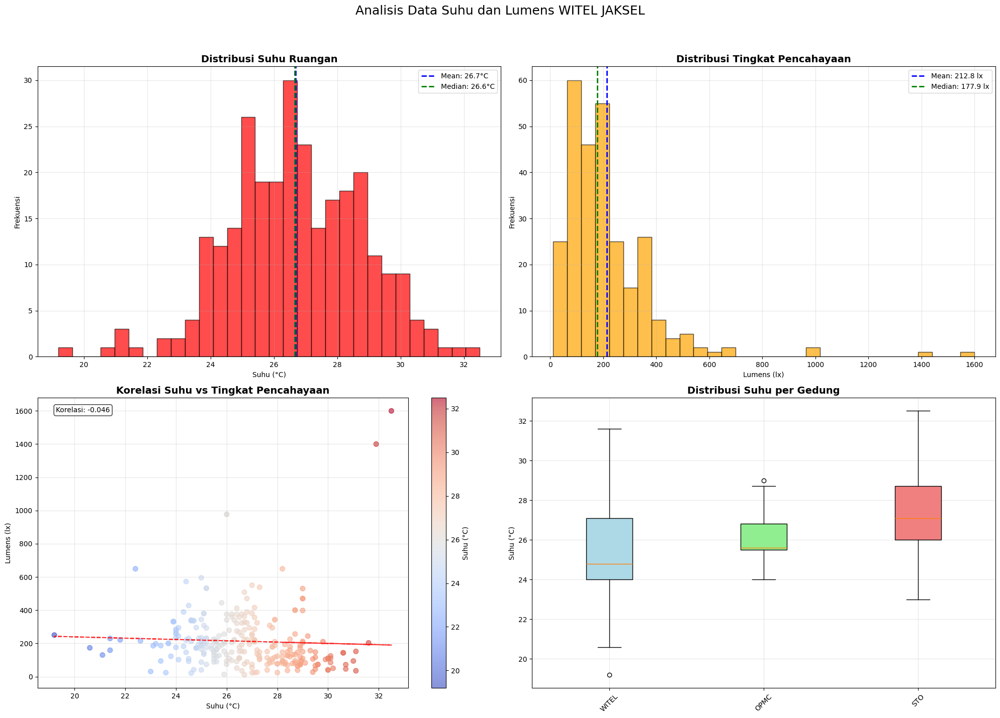


=== MEMBUAT ANALISIS DETAIL ===


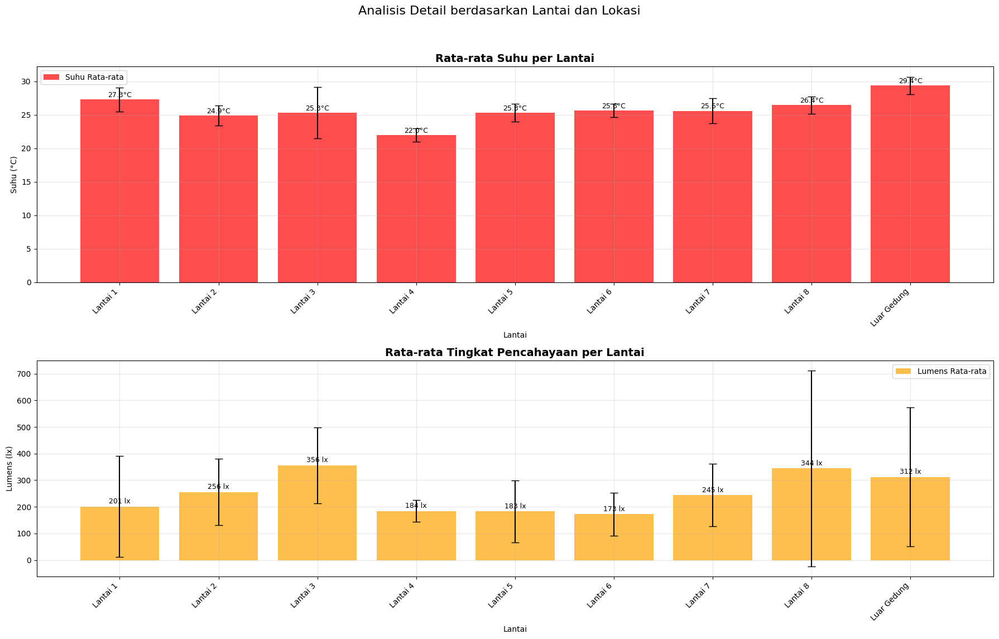


=== RINGKASAN STATISTIK ===
Total ruangan yang diukur: 278
Jumlah gedung: 3
Jumlah lantai: 9

Statistik Suhu:
  Rata-rata: 26.69°C
  Median: 26.65°C
  Minimum: 19.20°C
  Maksimum: 32.50°C
  Standar Deviasi: 2.12°C

Statistik Lumens:
  Rata-rata: 212.83 lx
  Median: 177.90 lx
  Minimum: 11.00 lx
  Maksimum: 1600.00 lx
  Standar Deviasi: 179.63 lx

Korelasi Suhu vs Lumens: -0.046

Statistik per Gedung:
            Suhu_Celsius             Lumens_lx              
                    mean   std count      mean     std count
Nama_Gedung                                                 
OPMC               26.20  1.34    26    212.00  118.66    26
STO                27.33  1.81   179    201.41  193.00   179
WITEL              25.30  2.33    73    241.11  161.30    73

Data hasil analisis tersimpan: hasil_analisis_suhu_lumens_20250716_131528.csv

=== ANALISIS SELESAI ===


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings

warnings.filterwarnings('ignore')

# Set style untuk visualisasi yang lebih baik
plt.style.use('default')
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 10

def load_and_preprocess_data(filename):
    """
    Load dan preprocess data suhu dan lumens
    """
    try:
        print(f"=== LOADING DATA ===")
        
        # Load data dengan header yang benar
        df = pd.read_csv(filename, skiprows=1)  # Skip empty first row
        
        # Bersihkan kolom yang kosong
        df = df.dropna(how='all', axis=1)  # Drop columns yang semua NaN
        df = df.dropna(how='all', axis=0)   # Drop rows yang semua NaN
        
        print(f"Data berhasil dimuat: {df.shape}")
        print(f"Kolom data: {list(df.columns)}")
        
        # Rename kolom untuk kemudahan
        df.columns = ['Nama_Gedung', 'Lantai', 'Ruangan', 'Suhu_Celsius', 'Lumens_lx']
        
        # Hapus baris yang kosong atau tidak valid
        df = df.dropna(subset=['Suhu_Celsius', 'Lumens_lx'])
        
        # Konversi ke numerik
        df['Suhu_Celsius'] = pd.to_numeric(df['Suhu_Celsius'], errors='coerce')
        df['Lumens_lx'] = pd.to_numeric(df['Lumens_lx'], errors='coerce')
        
        # Hapus outlier yang ekstrem (misal suhu 130 pada data Working Space)
        df = df[(df['Suhu_Celsius'] >= 15) & (df['Suhu_Celsius'] <= 40)]
        df = df[(df['Lumens_lx'] >= 0) & (df['Lumens_lx'] <= 2000)]
        
        # Fill forward untuk nama gedung dan lantai yang kosong
        df['Nama_Gedung'] = df['Nama_Gedung'].fillna(method='ffill')
        df['Lantai'] = df['Lantai'].fillna(method='ffill')
        
        # Gabungkan gedung dan lantai untuk kategori yang lebih jelas
        df['Lokasi'] = df['Nama_Gedung'] + ' - ' + df['Lantai'].astype(str)
        
        print(f"Data final setelah preprocessing: {df.shape}")
        print(f"Missing values: {df.isnull().sum().sum()}")
        
        return df
        
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

def create_comprehensive_analysis(df):
    """
    Membuat analisis komprehensif data suhu dan lumens
    """
    if df.empty:
        print("Warning: No data available for analysis")
        return
    
    # Buat figure dengan 4 subplot
    fig, axes = plt.subplots(2, 2, figsize=(20, 15))
    fig.suptitle('Analisis Data Suhu dan Lumens WITEL JAKSEL', fontsize=18, y=0.98)
    
    # Plot 1: Distribusi Suhu
    ax1 = axes[0, 0]
    df['Suhu_Celsius'].hist(bins=30, ax=ax1, color='red', alpha=0.7, edgecolor='black')
    ax1.axvline(df['Suhu_Celsius'].mean(), color='blue', linestyle='--', linewidth=2, 
                label=f'Mean: {df["Suhu_Celsius"].mean():.1f}°C')
    ax1.axvline(df['Suhu_Celsius'].median(), color='green', linestyle='--', linewidth=2,
                label=f'Median: {df["Suhu_Celsius"].median():.1f}°C')
    ax1.set_title('Distribusi Suhu Ruangan', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Suhu (°C)')
    ax1.set_ylabel('Frekuensi')
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # Plot 2: Distribusi Lumens
    ax2 = axes[0, 1]
    df['Lumens_lx'].hist(bins=30, ax=ax2, color='orange', alpha=0.7, edgecolor='black')
    ax2.axvline(df['Lumens_lx'].mean(), color='blue', linestyle='--', linewidth=2,
                label=f'Mean: {df["Lumens_lx"].mean():.1f} lx')
    ax2.axvline(df['Lumens_lx'].median(), color='green', linestyle='--', linewidth=2,
                label=f'Median: {df["Lumens_lx"].median():.1f} lx')
    ax2.set_title('Distribusi Tingkat Pencahayaan', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Lumens (lx)')
    ax2.set_ylabel('Frekuensi')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # Plot 3: Scatter Plot Suhu vs Lumens
    ax3 = axes[1, 0]
    scatter = ax3.scatter(df['Suhu_Celsius'], df['Lumens_lx'], 
                         alpha=0.6, s=50, c=df['Suhu_Celsius'], cmap='coolwarm')
    ax3.set_title('Korelasi Suhu vs Tingkat Pencahayaan', fontsize=14, fontweight='bold')
    ax3.set_xlabel('Suhu (°C)')
    ax3.set_ylabel('Lumens (lx)')
    ax3.grid(True, alpha=0.3)
    plt.colorbar(scatter, ax=ax3, label='Suhu (°C)')
    
    # Tambahkan trendline
    z = np.polyfit(df['Suhu_Celsius'], df['Lumens_lx'], 1)
    p = np.poly1d(z)
    ax3.plot(df['Suhu_Celsius'], p(df['Suhu_Celsius']), "r--", alpha=0.8)
    
    # Hitung korelasi
    correlation = df['Suhu_Celsius'].corr(df['Lumens_lx'])
    ax3.text(0.05, 0.95, f'Korelasi: {correlation:.3f}', 
             transform=ax3.transAxes, bbox=dict(boxstyle="round", facecolor='white', alpha=0.8))
    
    # Plot 4: Box Plot per Gedung
    ax4 = axes[1, 1]
    gedung_data = []
    gedung_labels = []
    
    for gedung in df['Nama_Gedung'].unique():
        if pd.notna(gedung):
            gedung_suhu = df[df['Nama_Gedung'] == gedung]['Suhu_Celsius'].dropna()
            if len(gedung_suhu) > 0:
                gedung_data.append(gedung_suhu)
                gedung_labels.append(gedung)
    
    if gedung_data:
        box_plot = ax4.boxplot(gedung_data, labels=gedung_labels, patch_artist=True)
        colors = ['lightblue', 'lightgreen', 'lightcoral']
        for patch, color in zip(box_plot['boxes'], colors):
            patch.set_facecolor(color)
    
    ax4.set_title('Distribusi Suhu per Gedung', fontsize=14, fontweight='bold')
    ax4.set_ylabel('Suhu (°C)')
    ax4.tick_params(axis='x', rotation=45)
    ax4.grid(True, alpha=0.3)
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.savefig('analisis_suhu_lumens_witel_jaksel.png', dpi=300, bbox_inches='tight')
    plt.show()

def create_detailed_analysis(df):
    """
    Membuat analisis detail berdasarkan lantai dan lokasi
    """
    if df.empty:
        print("Warning: No data available for detailed analysis")
        return
    
    # Analisis per lantai
    fig, axes = plt.subplots(2, 1, figsize=(18, 12))
    fig.suptitle('Analisis Detail berdasarkan Lantai dan Lokasi', fontsize=16, y=0.98)
    
    # Plot 1: Rata-rata suhu per lantai
    ax1 = axes[0]
    
    # Group by lantai dan hitung rata-rata
    lantai_stats = df.groupby('Lantai').agg({
        'Suhu_Celsius': ['mean', 'std', 'count'],
        'Lumens_lx': ['mean', 'std', 'count']
    }).round(2)
    
    # Flatten column names
    lantai_stats.columns = ['_'.join(col).strip() for col in lantai_stats.columns.values]
    
    # Plot bar chart untuk suhu rata-rata per lantai
    lantai_list = lantai_stats.index.tolist()
    suhu_mean = lantai_stats['Suhu_Celsius_mean'].values
    suhu_std = lantai_stats['Suhu_Celsius_std'].values
    
    x_pos = np.arange(len(lantai_list))
    bars1 = ax1.bar(x_pos, suhu_mean, yerr=suhu_std, capsize=5, 
                    color='red', alpha=0.7, label='Suhu Rata-rata')
    
    ax1.set_title('Rata-rata Suhu per Lantai', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Lantai')
    ax1.set_ylabel('Suhu (°C)')
    ax1.set_xticks(x_pos)
    ax1.set_xticklabels(lantai_list, rotation=45, ha='right')
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    
    # Tambahkan nilai di atas bar
    for bar, value in zip(bars1, suhu_mean):
        ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1, 
                f'{value:.1f}°C', ha='center', va='bottom', fontsize=9)
    
    # Plot 2: Rata-rata lumens per lantai
    ax2 = axes[1]
    
    lumens_mean = lantai_stats['Lumens_lx_mean'].values
    lumens_std = lantai_stats['Lumens_lx_std'].values
    
    bars2 = ax2.bar(x_pos, lumens_mean, yerr=lumens_std, capsize=5,
                    color='orange', alpha=0.7, label='Lumens Rata-rata')
    
    ax2.set_title('Rata-rata Tingkat Pencahayaan per Lantai', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Lantai')
    ax2.set_ylabel('Lumens (lx)')
    ax2.set_xticks(x_pos)
    ax2.set_xticklabels(lantai_list, rotation=45, ha='right')
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    
    # Tambahkan nilai di atas bar
    for bar, value in zip(bars2, lumens_mean):
        ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 5, 
                f'{value:.0f} lx', ha='center', va='bottom', fontsize=9)
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.savefig('analisis_detail_lantai_witel_jaksel.png', dpi=300, bbox_inches='tight')
    plt.show()

def create_summary_statistics(df):
    """
    Membuat ringkasan statistik
    """
    print("\n=== RINGKASAN STATISTIK ===")
    
    if df.empty:
        print("Tidak ada data untuk dianalisis")
        return
    
    # Statistik dasar
    print(f"Total ruangan yang diukur: {len(df)}")
    print(f"Jumlah gedung: {df['Nama_Gedung'].nunique()}")
    print(f"Jumlah lantai: {df['Lantai'].nunique()}")
    
    print(f"\nStatistik Suhu:")
    print(f"  Rata-rata: {df['Suhu_Celsius'].mean():.2f}°C")
    print(f"  Median: {df['Suhu_Celsius'].median():.2f}°C")
    print(f"  Minimum: {df['Suhu_Celsius'].min():.2f}°C")
    print(f"  Maksimum: {df['Suhu_Celsius'].max():.2f}°C")
    print(f"  Standar Deviasi: {df['Suhu_Celsius'].std():.2f}°C")
    
    print(f"\nStatistik Lumens:")
    print(f"  Rata-rata: {df['Lumens_lx'].mean():.2f} lx")
    print(f"  Median: {df['Lumens_lx'].median():.2f} lx")
    print(f"  Minimum: {df['Lumens_lx'].min():.2f} lx")
    print(f"  Maksimum: {df['Lumens_lx'].max():.2f} lx")
    print(f"  Standar Deviasi: {df['Lumens_lx'].std():.2f} lx")
    
    # Korelasi
    correlation = df['Suhu_Celsius'].corr(df['Lumens_lx'])
    print(f"\nKorelasi Suhu vs Lumens: {correlation:.3f}")
    
    # Statistik per gedung
    print(f"\nStatistik per Gedung:")
    gedung_stats = df.groupby('Nama_Gedung').agg({
        'Suhu_Celsius': ['mean', 'std', 'count'],
        'Lumens_lx': ['mean', 'std', 'count']
    }).round(2)
    
    print(gedung_stats)

def main():
    """
    Fungsi utama untuk menjalankan analisis
    """
    print("=== ANALISIS DATA SUHU DAN LUMENS WITEL JAKSEL ===")
    print(f"Tanggal analisis: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    
    # Load data
    df = load_and_preprocess_data('Data_Suhu_Lumens_WITEL_JAKSEL.csv')
    
    if df is None:
        print("Error: Gagal memuat data")
        return
    
    # Buat analisis komprehensif
    print("\n=== MEMBUAT VISUALISASI KOMPREHENSIF ===")
    create_comprehensive_analysis(df)
    
    # Buat analisis detail
    print("\n=== MEMBUAT ANALISIS DETAIL ===")
    create_detailed_analysis(df)
    
    # Buat ringkasan statistik
    create_summary_statistics(df)
    
    # Simpan hasil ke CSV
    output_filename = f'hasil_analisis_suhu_lumens_{datetime.now().strftime("%Y%m%d_%H%M%S")}.csv'
    df.to_csv(output_filename, index=False)
    print(f"\nData hasil analisis tersimpan: {output_filename}")
    
    print("\n=== ANALISIS SELESAI ===")

# Jalankan program
if __name__ == "__main__":
    main()


ANALISIS DATA BEBAN LISTRIK GEDUNG - RAW DATA
Advanced Energy Management Analysis - DATA CLEANING VERSION
Tanggal analisis: 2025-07-16 15:18:38
=== LOADING DATA BEBAN LISTRIK GEDUNG RAW ===
Data berhasil dimuat: (888, 15)
Kolom data asli: ['LANTAI ', 'RUANG', 'LUAS M2', 'JENIS  ', 'KELOMPOK ', 'JUMLAH ', 'WATT ', 'DURASI ON (JAM)', 'KETERANGAN ', 'Total Watt ', ' Factor day  ', 'Monthly ', 'Watt Monthly ', 'Unnamed: 13', 'Unnamed: 14']
Kolom setelah cleaning: ['LANTAI', 'RUANG', 'LUAS M2', 'JENIS', 'KELOMPOK', 'JUMLAH', 'WATT', 'DURASI ON (JAM)', 'KETERANGAN', 'Total Watt', 'Factor day', 'Monthly', 'Watt Monthly']
Kolom setelah mapping: ['lantai', 'ruang', 'luas_m2', 'jenis', 'kelompok', 'jumlah', 'watt', 'durasi', 'keterangan', 'total_watt', 'factor_day', 'monthly', 'watt_monthly']
Data sebelum filtering: 888 rows
Setelah hapus baris kosong: 888 rows
Setelah filter kelompok: 867 rows
Processing kolom numerik: jumlah
Processing kolom numerik: watt
Processing kolom numerik: durasi
Proce

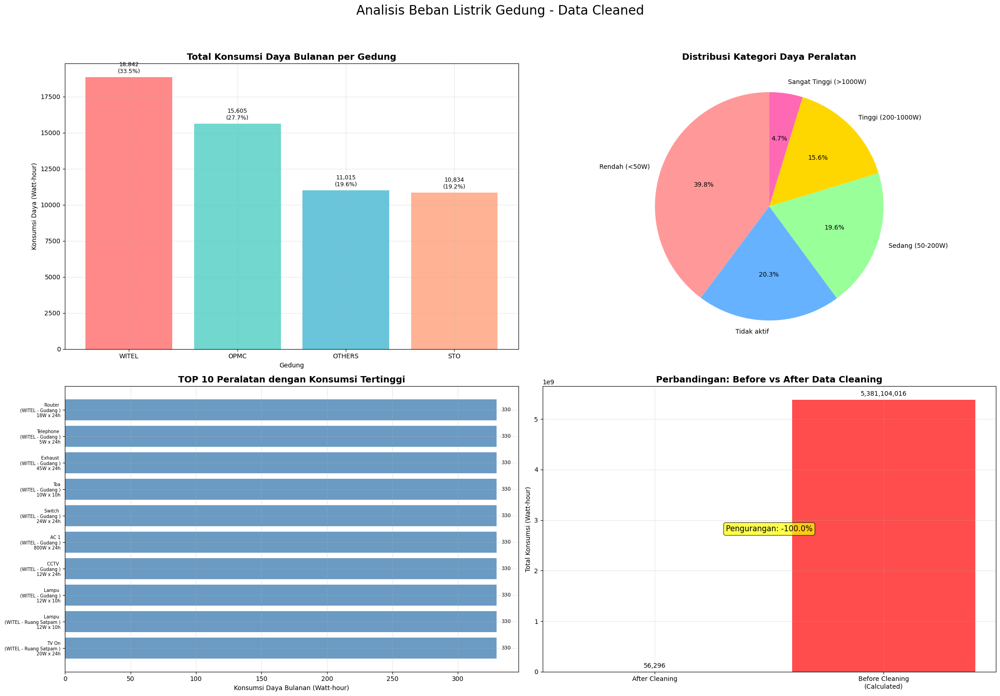

✓ Analisis komprehensif selesai

=== MEMBUAT ANALISIS DETAIL RUANGAN ===
✓ Data validation berhasil


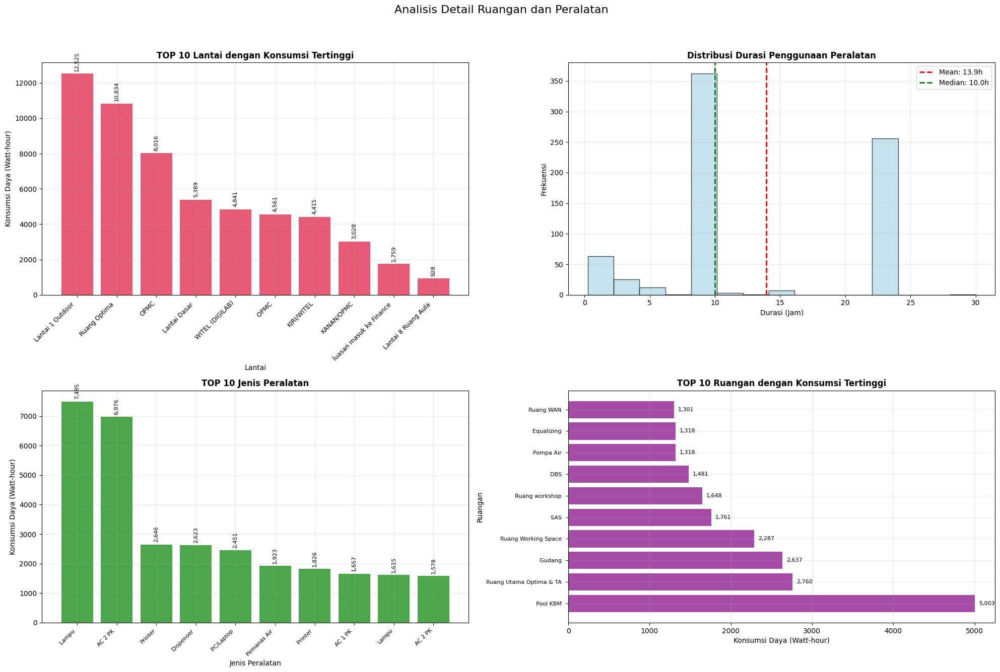

✓ Analisis detail ruangan selesai

=== MEMBUAT ANALISIS EFISIENSI ===
✓ Data validation berhasil


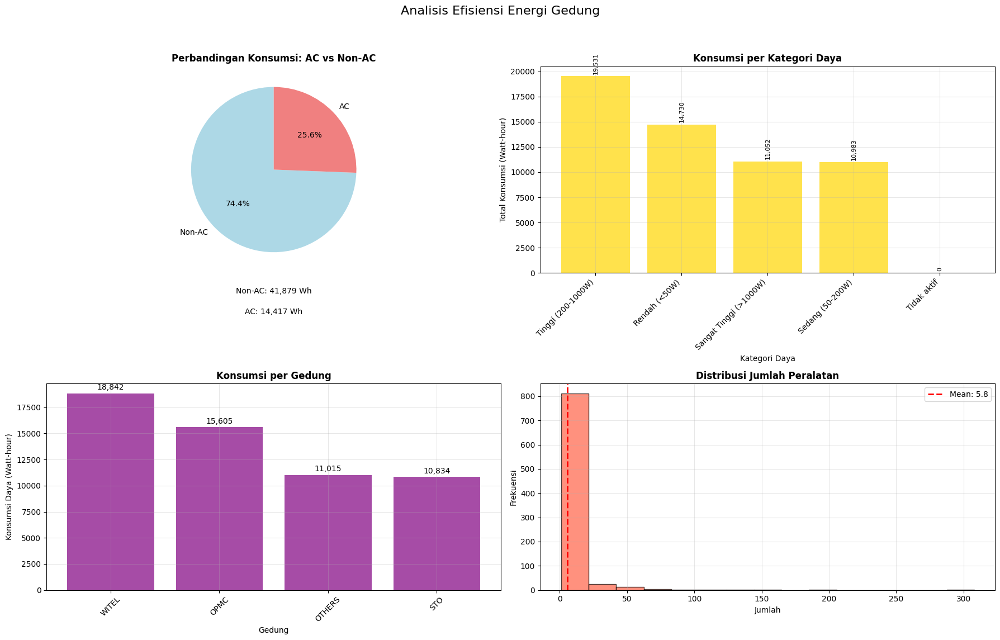

✓ Analisis efisiensi selesai

LAPORAN RINGKASAN ANALISIS BEBAN LISTRIK GEDUNG
DATA CLEANED VERSION
✓ Data validation berhasil
Total peralatan yang dianalisis: 867
Total gedung: 4
Total lantai: 10
Total ruangan: 137
Jenis peralatan: 110

HASIL DATA CLEANING:
  Peralatan yang dikoreksi power-nya: 38 (4.4%)
  Pengurangan konsumsi setelah cleaning: 100.0%

Konsumsi Listrik (Setelah Cleaning):
  Total konsumsi bulanan: 56,296 Watt-hour
  Rata-rata konsumsi per peralatan: 74 Watt-hour
  Konsumsi tertinggi: 330 Watt-hour
  Konsumsi terendah: 0 Watt-hour

Konsumsi per Gedung:
  OPMC:
    Total: 15,605 Watt-hour (27.7%)
    Rata-rata: 57 Watt-hour
    Jumlah peralatan: 274
  OTHERS:
    Total: 11,015 Watt-hour (19.6%)
    Rata-rata: 48 Watt-hour
    Jumlah peralatan: 228
  STO:
    Total: 10,834 Watt-hour (19.2%)
    Rata-rata: 87 Watt-hour
    Jumlah peralatan: 125
  WITEL:
    Total: 18,842 Watt-hour (33.5%)
    Rata-rata: 137 Watt-hour
    Jumlah peralatan: 138

TOP 10 Peralatan dengan Konsu

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import warnings
import seaborn as sns
import os

warnings.filterwarnings('ignore')

# Set style untuk visualisasi yang lebih baik
plt.style.use('default')
plt.rcParams['figure.autolayout'] = True

def validate_and_clean_timestamps(df):
    """
    Validasi dan pembersihan timestamp yang tidak valid
    """
    print(f"\n=== VALIDASI TIMESTAMP ===")
    
    # Set rentang tahun yang valid (2023-2025)
    valid_year_start = 2023
    valid_year_end = 2025
    
    # Tampilkan info sebelum cleaning
    print(f"Data sebelum cleaning: {len(df)} records")
    print(f"Rentang tahun dalam data: {df.index.year.min()} - {df.index.year.max()}")
    
    # Identifikasi data dengan tahun yang tidak valid
    invalid_years = df[
        (df.index.year < valid_year_start) | 
        (df.index.year > valid_year_end)
    ]
    
    if not invalid_years.empty:
        print(f"Ditemukan {len(invalid_years)} record dengan timestamp invalid:")
        print(f"  - Tahun < {valid_year_start}: {len(df[df.index.year < valid_year_start])}")
        print(f"  - Tahun > {valid_year_end}: {len(df[df.index.year > valid_year_end])}")
        
        # Hapus data dengan timestamp invalid
        df_clean = df[
            (df.index.year >= valid_year_start) & 
            (df.index.year <= valid_year_end)
        ]
        
        print(f"\nData setelah cleaning: {len(df_clean)} records")
        print(f"Records dihapus: {len(df) - len(df_clean)}")
        
        return df_clean
    else:
        print("Tidak ada timestamp invalid yang ditemukan")
        return df

def aggressive_interpolation(series, max_gap_fill=24):
    """
    Interpolasi yang lebih agresif untuk mengisi gap dan menghilangkan garis datar
    """
    result = series.copy()
    
    # Interpolasi linear untuk gap sedang
    result = result.interpolate(method='linear', limit=max_gap_fill)
    
    # Untuk gap yang masih tersisa, gunakan metode kombinasi
    if result.isnull().sum() > 0:
        # Interpolasi spline untuk smoothing
        try:
            result = result.interpolate(method='spline', order=2, limit=max_gap_fill)
        except:
            # Fallback ke linear jika spline gagal
            result = result.interpolate(method='linear', limit=max_gap_fill)
        
        # Forward fill untuk gap pendek
        result = result.fillna(method='ffill', limit=12)
        result = result.fillna(method='bfill', limit=12)
    
    return result

def seasonal_fill_gaps(data, freq='H'):
    """
    Mengisi gap dengan pola seasonal berdasarkan jam
    """
    result = data.copy()
    
    # Hitung rata-rata per jam
    hourly_pattern = result.groupby(result.index.hour).mean()
    
    # Isi gap dengan pattern yang sesuai
    null_indices = result[result.isnull()].index
    for idx in null_indices:
        hour = idx.hour
        if hour in hourly_pattern.index and not pd.isna(hourly_pattern.loc[hour]):
            result.loc[idx] = hourly_pattern.loc[hour]
    
    return result

def complete_gap_filling(meter_data):
    """
    Mengisi semua gap dalam data occupancy untuk visualisasi yang smooth
    """
    print("  Applying complete gap filling...")
    
    # Buat complete time range
    full_range = pd.date_range(
        start=meter_data.index.min(),
        end=meter_data.index.max(),
        freq='30min'
    )
    
    # Reindex untuk memastikan semua timestamp ada
    meter_data = meter_data.reindex(full_range)
    
    # Interpolasi bertahap untuk setiap kolom numerik
    for col in meter_data.select_dtypes(include=[np.number]).columns:
        if meter_data[col].notna().sum() > 0:
            # Step 1: Aggressive linear interpolation
            meter_data[col] = aggressive_interpolation(meter_data[col])
            
            # Step 2: Seasonal interpolation untuk gap yang tersisa
            if meter_data[col].isnull().sum() > 0:
                meter_data[col] = seasonal_fill_gaps(meter_data[col])
            
            # Step 3: Final forward/backward fill
            meter_data[col] = meter_data[col].fillna(method='ffill')
            meter_data[col] = meter_data[col].fillna(method='bfill')
    
    print(f"  Gap filling completed. Remaining NaN: {meter_data.isnull().sum().sum()}")
    return meter_data

def load_and_preprocess_data(filename):
    """
    Load dan preprocess data occupancy
    """
    try:
        print(f"=== LOADING DATA OCCUPANCY ===")
        
        # Check if file exists
        if not os.path.exists(filename):
            print(f"Error: File {filename} tidak ditemukan")
            return None
        
        df = pd.read_csv(filename)
        print(f"Data berhasil dimuat: {df.shape}")
        print(f"Kolom dalam data: {list(df.columns)}")
        
        # Tampilkan sample data
        print("\nSample data:")
        print(df.head())
        
        # Identifikasi kolom datetime (cari kolom yang mengandung kata 'time', 'date', 'timestamp')
        datetime_cols = [col for col in df.columns if any(word in col.lower() for word in ['time', 'date', 'timestamp'])]
        
        if not datetime_cols:
            # Jika tidak ada, coba kolom pertama
            datetime_col = df.columns[0]
            print(f"Menggunakan kolom pertama sebagai datetime: {datetime_col}")
        else:
            datetime_col = datetime_cols[0]
            print(f"Kolom datetime terdeteksi: {datetime_col}")
        
        # Konversi kolom datetime
        df[datetime_col] = pd.to_datetime(df[datetime_col], errors='coerce')
        
        # Hapus record dengan timestamp invalid
        df = df.dropna(subset=[datetime_col])
        
        # Set datetime sebagai index
        df.set_index(datetime_col, inplace=True)
        
        # Urutkan data berdasarkan datetime
        df.sort_index(inplace=True)
        
        # Validasi dan bersihkan timestamp
        df = validate_and_clean_timestamps(df)
        
        # Konversi kolom numerik
        numeric_cols = df.select_dtypes(include=['object']).columns
        
        for col in numeric_cols:
            # Coba konversi ke numeric
            df[col] = pd.to_numeric(df[col], errors='coerce')
        
        print(f"Data final setelah preprocessing: {df.shape}")
        print(f"Missing values: {df.isnull().sum().sum()}")
        
        return df
    
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

def resample_occupancy_data(occupancy_data, area_id):
    """
    Resampling data occupancy dengan gap filling yang aggressive
    """
    print(f"  Processing area {area_id}: {len(occupancy_data)} records")
    
    # Validasi periode data
    if len(occupancy_data) < 5:
        print(f"  Warning: Insufficient data for area {area_id}")
        return None
    
    # Identifikasi kolom numerik
    numeric_cols = occupancy_data.select_dtypes(include=[np.number]).columns.tolist()
    
    # Filter kolom yang memiliki data valid
    available_cols = []
    for col in numeric_cols:
        non_null_count = occupancy_data[col].notna().sum()
        if non_null_count > 0:
            available_cols.append(col)
    
    if not available_cols:
        print(f"  Warning: No valid numeric columns found for area {area_id}")
        return None
    
    print(f"  Available columns with data: {available_cols}")
    
    # Ambil data numerik untuk resampling
    area_numeric = occupancy_data[available_cols]
    
    # Resampling ke interval 30 menit dengan mean
    try:
        resampled_area = area_numeric.resample('30min').mean()
        
        if resampled_area.empty:
            print(f"  Warning: Resampling resulted in empty dataframe for area {area_id}")
            return None
        
        # Tambahkan informasi area_id
        resampled_area['area_id'] = area_id
        
        # Apply complete gap filling untuk menghilangkan garis datar
        resampled_area = complete_gap_filling(resampled_area)
        
        # Hitung coverage setelah gap filling
        coverage = (resampled_area[available_cols].notna().sum().sum() / 
                   (len(resampled_area) * len(available_cols))) * 100
        
        print(f"  Successfully resampled to {len(resampled_area)} records")
        print(f"  Data coverage: {coverage:.1f}%")
        
        return resampled_area
        
    except Exception as e:
        print(f"  Error resampling area {area_id}: {e}")
        return None

def create_occupancy_visualization(sample_data, area_id):
    """
    Membuat visualisasi data occupancy dengan garis yang smooth
    """
    if sample_data.empty:
        print(f"Warning: No data available for visualization for area {area_id}")
        return
    
    # Tentukan plot mana yang memiliki data
    plot_configs = []
    
    # Identifikasi kolom numerik (exclude area_id)
    numeric_cols = [col for col in sample_data.select_dtypes(include=[np.number]).columns 
                   if col != 'area_id']
    
    # Buat konfigurasi plot untuk setiap kolom numerik
    colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray']
    
    for i, col in enumerate(numeric_cols):
        if sample_data[col].notna().sum() > 0:
            plot_configs.append({
                'type': 'line',
                'data': sample_data[col],
                'title': f'{col.replace("_", " ").title()}',
                'ylabel': f'{col.replace("_", " ").title()}',
                'color': colors[i % len(colors)]
            })
    
    if not plot_configs:
        print(f"No valid data available for visualization for area {area_id}")
        return
    
    # Buat subplot sesuai jumlah data yang tersedia
    n_plots = len(plot_configs)
    fig, axes = plt.subplots(n_plots, 1, figsize=(20, 5*n_plots))
    
    # Pastikan axes selalu berupa array
    if n_plots == 1:
        axes = [axes]
    
    fig.suptitle(f'Occupancy Data Analysis - Area {area_id}', fontsize=18, y=0.98)
    
    # Plot berdasarkan konfigurasi yang tersedia
    for i, config in enumerate(plot_configs):
        ax = axes[i]
        
        # Plot dengan data yang sudah di-fill untuk menghilangkan gap
        data_to_plot = config['data']
        
        # Plot line yang smooth
        ax.plot(data_to_plot.index, data_to_plot.values, 
               color=config['color'], linewidth=2, alpha=0.8)
        
        # Tambahkan scatter plot untuk menunjukkan data points
        ax.scatter(data_to_plot.index, data_to_plot.values, 
                  color=config['color'], s=1, alpha=0.5)
        
        # Set title dan label
        ax.set_title(config['title'], fontsize=16, pad=20)
        ax.set_ylabel(config['ylabel'], fontsize=14)
        
        # Format sumbu x
        ax.grid(True, alpha=0.3)
        ax.tick_params(axis='x', labelsize=11)
        ax.tick_params(axis='y', labelsize=12)
        
        # Format tanggal
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%d/%m/%Y'))
        ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
        plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')
    
    # Tambahkan xlabel hanya pada plot terakhir
    axes[-1].set_xlabel('Waktu (Tanggal dan Jam)', fontsize=14, fontweight='bold')
    
    # Tambahkan informasi periode data
    data_start = sample_data.index.min().strftime('%d/%m/%Y %H:%M')
    data_end = sample_data.index.max().strftime('%d/%m/%Y %H:%M')
    fig.text(0.5, 0.02, f'Periode Data: {data_start} - {data_end} (Interval: 30 menit)', 
             ha='center', fontsize=12, style='italic')
    
    # Adjust layout
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    
    # Create output directory
    output_dir = 'occupancy_analysis'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Save plot
    plt.savefig(f'{output_dir}/occupancy_analysis_{area_id}.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"Visualisasi berhasil dibuat dengan {n_plots} subplot aktif")

def create_occupancy_summary(resampled_data):
    """
    Membuat ringkasan statistik untuk data occupancy
    """
    print("\n=== RINGKASAN STATISTIK OCCUPANCY ===")
    
    if not resampled_data:
        print("Tidak ada data untuk dibuat statistik")
        return pd.DataFrame()
    
    summary_stats = []
    
    for area_id, data in resampled_data.items():
        if data.empty:
            continue
            
        valid_index = data.index.dropna()
        if valid_index.empty:
            continue
        
        stats = {
            'Area_ID': area_id,
            'Jumlah_Data': len(data),
            'Periode_Mulai': valid_index.min().strftime('%Y-%m-%d %H:%M'),
            'Periode_Akhir': valid_index.max().strftime('%Y-%m-%d %H:%M'),
            'Durasi_Hari': (valid_index.max() - valid_index.min()).days,
            'Missing_Values': data.isnull().sum().sum()
        }
        
        # Tambahkan statistik untuk setiap kolom numerik
        numeric_cols = [col for col in data.select_dtypes(include=[np.number]).columns 
                       if col != 'area_id']
        
        for col in numeric_cols:
            if data[col].notna().sum() > 0:
                stats[f'{col}_Mean'] = f"{data[col].mean():.2f}"
                stats[f'{col}_Max'] = f"{data[col].max():.2f}"
                stats[f'{col}_Min'] = f"{data[col].min():.2f}"
                stats[f'{col}_Std'] = f"{data[col].std():.2f}"
        
        summary_stats.append(stats)
    
    if not summary_stats:
        print("Warning: No valid data found for any area")
        return pd.DataFrame()
    
    # Tampilkan sebagai DataFrame
    summary_df = pd.DataFrame(summary_stats)
    print(summary_df.to_string(index=False))
    
    return summary_df

def main():
    """
    Fungsi utama untuk menjalankan analisis data occupancy
    """
    print("=== OCCUPANCY DATA ANALYSIS ===")
    print(f"Tanggal eksekusi: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    
    # Load data occupancy
    df = load_and_preprocess_data('DataOccupansi.csv')
    
    if df is None:
        print("Error: Gagal memuat data")
        return
    
    print(f"\n=== DATA ORIGINAL (SETELAH PREPROCESSING) ===")
    print(f"Shape: {df.shape}")
    print(f"Periode: {df.index.min()} - {df.index.max()}")
    
    # Tentukan kolom ID area (bisa berupa area_id, zone_id, atau kolom identifier lainnya)
    id_cols = [col for col in df.columns if any(word in col.lower() 
               for word in ['id', 'area', 'zone', 'room', 'location'])]
    
    if id_cols:
        area_col = id_cols[0]
        print(f"Kolom area/ID terdeteksi: {area_col}")
        
        # Kelompokkan data berdasarkan area
        area_groups = df.groupby(area_col)
        print(f"Jumlah area: {df[area_col].nunique()}")
    else:
        # Jika tidak ada kolom area, treat sebagai satu area
        area_groups = [('single_area', df)]
        print("Tidak ada kolom area terdeteksi, menganalisis sebagai satu area")
    
    # Dictionary untuk menyimpan hasil resampling per area
    resampled_data = {}
    
    print(f"\n=== PROSES RESAMPLING ===")
    
    # Proses resampling untuk setiap area
    for area_id, area_data in area_groups:
        resampled_area = resample_occupancy_data(area_data, area_id)
        
        if resampled_area is not None:
            resampled_data[area_id] = resampled_area
    
    if not resampled_data:
        print("Error: Tidak ada data yang berhasil di-resample")
        return
    
    # Gabungkan semua data area menjadi satu DataFrame
    all_resampled = pd.concat(resampled_data.values(), ignore_index=False)
    
    # Reset index untuk mendapatkan kolom datetime
    all_resampled = all_resampled.reset_index()
    
    # Informasi hasil proses
    print(f"\n=== HASIL RESAMPLING ===")
    print(f"Data setelah resampling: {all_resampled.shape}")
    print(f"Area berhasil diproses: {len(resampled_data)}")
    
    # Create output directory
    output_dir = 'occupancy_analysis'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Simpan hasil ke file CSV
    output_filename = f'{output_dir}/occupancy_resampled_30min_{datetime.now().strftime("%Y%m%d_%H%M%S")}.csv'
    all_resampled.to_csv(output_filename, index=False)
    print(f"File tersimpan: {output_filename}")
    
    # Buat ringkasan statistik
    summary_df = create_occupancy_summary(resampled_data)
    if not summary_df.empty:
        summary_filename = f'{output_dir}/occupancy_summary_stats_{datetime.now().strftime("%Y%m%d_%H%M%S")}.csv'
        summary_df.to_csv(summary_filename, index=False)
        print(f"Summary statistics tersimpan: {summary_filename}")
    
    # Visualisasi untuk area pertama yang berhasil
    if resampled_data:
        sample_area = list(resampled_data.keys())[0]
        sample_data = resampled_data[sample_area]
        
        print(f"\n=== MEMBUAT VISUALISASI UNTUK AREA {sample_area} ===")
        create_occupancy_visualization(sample_data, sample_area)
    
    print(f"\n=== PROSES SELESAI ===")
    print(f"Total area yang berhasil diproses: {len(resampled_data)}")
    print(f"Output disimpan di folder: {output_dir}")

# Jalankan program
if __name__ == "__main__":
    main()


ANALISIS DATA OCCUPANCY
Advanced Analytics for Occupancy Data
Tanggal eksekusi: 2025-07-16 17:53:12
=== LOADING OCCUPANCY DATA ===
Data berhasil dimuat: (86010, 4)
Kolom dalam data: ['timestamp', 'Lantai_No', 'Ruangan', 'Occupansi']
Sample data:
    timestamp  Lantai_No Ruangan  Occupansi
0  01/01/2024          1  Satpam          4
1  02/01/2024          1  Satpam          1
2  03/01/2024          1  Satpam          3
3  04/01/2024          1  Satpam          3
4  05/01/2024          1  Satpam          2
Records dengan timestamp invalid dihapus: 0
Data final setelah preprocessing: (86010, 7)
Periode data: 2024-01-01 00:00:00 - 2024-12-31 00:00:00
Jumlah ruangan: 120
Jumlah lantai: 8

=== ANALISIS POLA OCCUPANCY ===
Statistik Occupancy per Ruangan:
                  Occupansi_count  Occupansi_mean  Occupansi_std  \
Ruangan                                                            
Anet                          732            7.89           5.42   
Aula Dalam                    732     

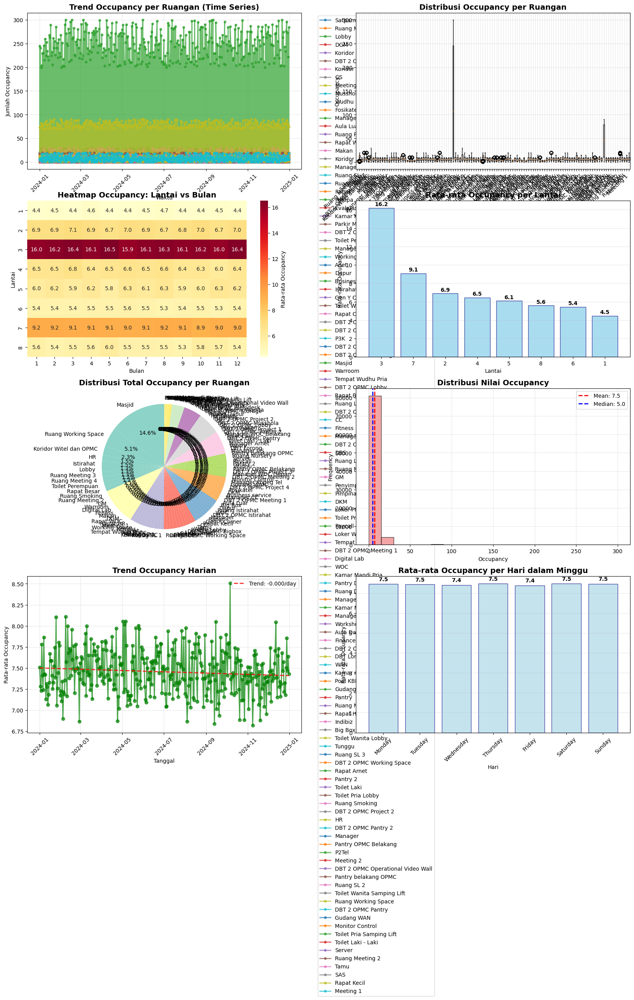

Visualisasi berhasil dibuat dan disimpan sebagai 'occupancy_analysis_comprehensive.png'

=== ANALISIS DETAIL PER RUANGAN ===


Analisis detail per ruangan berhasil dibuat dan disimpan sebagai 'detailed_room_analysis.png'

=== LAPORAN OCCUPANCY YANG KOMPREHENSIF ===
DATA OVERVIEW:
  Total records: 86,010
  Periode: 01/01/2024 - 31/12/2024
  Durasi: 365 hari
  Jumlah ruangan: 120
  Jumlah lantai: 8

STATISTIK OCCUPANCY GLOBAL:
  Total occupancy: 641,152
  Rata-rata occupancy: 7.45
  Median occupancy: 5.00
  Std deviation: 17.05
  Min occupancy: 0
  Max occupancy: 300

TOP 5 RUANGAN DENGAN OCCUPANCY TERTINGGI:
  1. Masjid: Total=93516.0, Rata-rata=127.8, Frekuensi=732.0
  2. Ruang Working Space: Total=32937.0, Rata-rata=45.0, Frekuensi=732.0
  3. Koridor Witel dan OPMC: Total=14942.0, Rata-rata=10.2, Frekuensi=1464.0
  4. HR: Total=9734.0, Rata-rata=6.6, Frekuensi=1464.0
  5. Istirahat: Total=9459.0, Rata-rata=6.5, Frekuensi=1464.0

ANALISIS PER LANTAI:
  Lantai 1:
    Jumlah ruangan: 17
    Total occupancy: 27746
    Rata-rata occupancy: 4.46
    Ruangan: Satpam, Pompa, Parkir Motor, P3K, Lobby, DBS, Pantry DBS,

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Set style untuk visualisasi yang lebih baik
plt.style.use('default')
plt.rcParams['figure.autolayout'] = True
plt.rcParams['figure.figsize'] = (15, 10)

def load_and_preprocess_occupancy_data(filename):
    """
    Load dan preprocess data occupancy dengan validasi yang komprehensif
    """
    try:
        print(f"=== LOADING OCCUPANCY DATA ===")
        df = pd.read_csv(filename)
        print(f"Data berhasil dimuat: {df.shape}")
        
        # Tampilkan info dasar
        print(f"Kolom dalam data: {list(df.columns)}")
        print(f"Sample data:")
        print(df.head())
        
        # Konversi kolom timestamp ke format datetime
        df['timestamp'] = pd.to_datetime(df['timestamp'], format='%d/%m/%Y', errors='coerce')
        
        # Hapus record dengan timestamp invalid
        initial_count = len(df)
        df = df.dropna(subset=['timestamp'])
        print(f"Records dengan timestamp invalid dihapus: {initial_count - len(df)}")
        
        # Set timestamp sebagai index
        df.set_index('timestamp', inplace=True)
        
        # Urutkan data berdasarkan datetime
        df.sort_index(inplace=True)
        
        # Konversi kolom numerik
        df['Occupansi'] = pd.to_numeric(df['Occupansi'], errors='coerce')
        df['Lantai_No'] = pd.to_numeric(df['Lantai_No'], errors='coerce')
        
        # Hapus data dengan occupancy invalid
        df = df.dropna(subset=['Occupansi'])
        
        # Buat kolom turunan untuk analisis
        df['bulan'] = df.index.month
        df['tahun'] = df.index.year
        df['hari_minggu'] = df.index.dayofweek
        df['nama_hari'] = df.index.day_name()
        
        print(f"Data final setelah preprocessing: {df.shape}")
        print(f"Periode data: {df.index.min()} - {df.index.max()}")
        print(f"Jumlah ruangan: {df['Ruangan'].nunique()}")
        print(f"Jumlah lantai: {df['Lantai_No'].nunique()}")
        
        return df
    
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

def analyze_occupancy_patterns(df):
    """
    Analisis pola occupancy berdasarkan berbagai dimensi
    """
    print(f"\n=== ANALISIS POLA OCCUPANCY ===")
    
    # 1. Statistik dasar per ruangan
    room_stats = df.groupby('Ruangan').agg({
        'Occupansi': ['count', 'mean', 'std', 'min', 'max'],
        'Lantai_No': 'first'
    }).round(2)
    
    # Flatten column names
    room_stats.columns = ['_'.join(col).strip() for col in room_stats.columns.values]
    room_stats = room_stats.rename(columns={'Lantai_No_first': 'Lantai'})
    
    print("Statistik Occupancy per Ruangan:")
    print(room_stats)
    
    # 2. Analisis per lantai
    floor_stats = df.groupby('Lantai_No').agg({
        'Occupansi': ['count', 'mean', 'std', 'min', 'max'],
        'Ruangan': 'nunique'
    }).round(2)
    
    floor_stats.columns = ['_'.join(col).strip() for col in floor_stats.columns.values]
    floor_stats = floor_stats.rename(columns={'Ruangan_nunique': 'Jumlah_Ruangan'})
    
    print("\nStatistik Occupancy per Lantai:")
    print(floor_stats)
    
    # 3. Analisis temporal
    monthly_stats = df.groupby('bulan').agg({
        'Occupansi': ['count', 'mean', 'std']
    }).round(2)
    
    monthly_stats.columns = ['_'.join(col).strip() for col in monthly_stats.columns.values]
    
    print("\nPola Occupancy per Bulan:")
    print(monthly_stats)
    
    return room_stats, floor_stats, monthly_stats

def create_occupancy_visualization(df):
    """
    Membuat visualisasi komprehensif untuk data occupancy
    """
    print(f"\n=== MEMBUAT VISUALISASI OCCUPANCY ===")
    
    # Set up figure dengan multiple subplots
    fig = plt.figure(figsize=(20, 24))
    
    # 1. Time series occupancy untuk setiap ruangan
    plt.subplot(4, 2, 1)
    for ruangan in df['Ruangan'].unique():
        room_data = df[df['Ruangan'] == ruangan]
        plt.plot(room_data.index, room_data['Occupansi'], 
                marker='o', markersize=4, linewidth=2, alpha=0.7, label=ruangan)
    
    plt.title('Trend Occupancy per Ruangan (Time Series)', fontsize=14, fontweight='bold')
    plt.xlabel('Waktu')
    plt.ylabel('Jumlah Occupancy')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    
    # 2. Box plot occupancy per ruangan
    plt.subplot(4, 2, 2)
    rooms = df['Ruangan'].unique()
    occupancy_by_room = [df[df['Ruangan'] == room]['Occupansi'].values for room in rooms]
    
    plt.boxplot(occupancy_by_room, labels=rooms)
    plt.title('Distribusi Occupancy per Ruangan', fontsize=14, fontweight='bold')
    plt.xlabel('Ruangan')
    plt.ylabel('Occupancy')
    plt.xticks(rotation=45, ha='right')
    plt.grid(True, alpha=0.3)
    
    # 3. Heatmap occupancy per lantai dan bulan
    plt.subplot(4, 2, 3)
    pivot_data = df.pivot_table(values='Occupansi', index='Lantai_No', 
                               columns='bulan', aggfunc='mean')
    
    sns.heatmap(pivot_data, annot=True, fmt='.1f', cmap='YlOrRd', 
                cbar_kws={'label': 'Rata-rata Occupancy'})
    plt.title('Heatmap Occupancy: Lantai vs Bulan', fontsize=14, fontweight='bold')
    plt.xlabel('Bulan')
    plt.ylabel('Lantai')
    
    # 4. Bar chart rata-rata occupancy per lantai
    plt.subplot(4, 2, 4)
    floor_avg = df.groupby('Lantai_No')['Occupansi'].mean().sort_values(ascending=False)
    
    bars = plt.bar(floor_avg.index.astype(str), floor_avg.values, 
                   color='skyblue', alpha=0.7, edgecolor='navy')
    plt.title('Rata-rata Occupancy per Lantai', fontsize=14, fontweight='bold')
    plt.xlabel('Lantai')
    plt.ylabel('Rata-rata Occupancy')
    plt.grid(True, alpha=0.3, axis='y')
    
    # Tambahkan nilai di atas bar
    for bar, value in zip(bars, floor_avg.values):
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                f'{value:.1f}', ha='center', va='bottom', fontweight='bold')
    
    # 5. Pie chart distribusi occupancy per ruangan
    plt.subplot(4, 2, 5)
    room_total = df.groupby('Ruangan')['Occupansi'].sum().sort_values(ascending=False)
    
    plt.pie(room_total.values, labels=room_total.index, autopct='%1.1f%%',
            startangle=90, colors=plt.cm.Set3(np.linspace(0, 1, len(room_total))))
    plt.title('Distribusi Total Occupancy per Ruangan', fontsize=14, fontweight='bold')
    
    # 6. Histogram distribusi occupancy
    plt.subplot(4, 2, 6)
    plt.hist(df['Occupansi'], bins=20, alpha=0.7, color='lightcoral', edgecolor='black')
    plt.axvline(df['Occupansi'].mean(), color='red', linestyle='--', 
                linewidth=2, label=f'Mean: {df["Occupansi"].mean():.1f}')
    plt.axvline(df['Occupansi'].median(), color='blue', linestyle='--', 
                linewidth=2, label=f'Median: {df["Occupansi"].median():.1f}')
    
    plt.title('Distribusi Nilai Occupancy', fontsize=14, fontweight='bold')
    plt.xlabel('Occupancy')
    plt.ylabel('Frequency')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # 7. Timeline occupancy dengan trend
    plt.subplot(4, 2, 7)
    daily_avg = df.groupby(df.index.date)['Occupansi'].mean()
    
    plt.plot(daily_avg.index, daily_avg.values, 'o-', linewidth=2, 
             markersize=6, color='green', alpha=0.7)
    
    # Tambahkan trend line
    x_numeric = np.arange(len(daily_avg))
    z = np.polyfit(x_numeric, daily_avg.values, 1)
    p = np.poly1d(z)
    plt.plot(daily_avg.index, p(x_numeric), "r--", alpha=0.8, linewidth=2,
             label=f'Trend: {z[0]:.3f}/day')
    
    plt.title('Trend Occupancy Harian', fontsize=14, fontweight='bold')
    plt.xlabel('Tanggal')
    plt.ylabel('Rata-rata Occupancy')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    
    # 8. Occupancy per hari dalam minggu
    plt.subplot(4, 2, 8)
    weekday_avg = df.groupby('nama_hari')['Occupansi'].mean()
    
    # Urutkan berdasarkan hari dalam minggu
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    weekday_avg = weekday_avg.reindex([day for day in day_order if day in weekday_avg.index])
    
    bars = plt.bar(weekday_avg.index, weekday_avg.values, 
                   color='lightblue', alpha=0.7, edgecolor='navy')
    plt.title('Rata-rata Occupancy per Hari dalam Minggu', fontsize=14, fontweight='bold')
    plt.xlabel('Hari')
    plt.ylabel('Rata-rata Occupancy')
    plt.xticks(rotation=45)
    plt.grid(True, alpha=0.3, axis='y')
    
    # Tambahkan nilai di atas bar
    for bar, value in zip(bars, weekday_avg.values):
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                f'{value:.1f}', ha='center', va='bottom', fontweight='bold')
    
    # Adjust layout
    plt.tight_layout()
    
    # Save plot
    plt.savefig('occupancy_analysis_comprehensive.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print("Visualisasi berhasil dibuat dan disimpan sebagai 'occupancy_analysis_comprehensive.png'")

def create_detailed_room_analysis(df):
    """
    Analisis detail per ruangan
    """
    print(f"\n=== ANALISIS DETAIL PER RUANGAN ===")
    
    # Buat subplot untuk setiap ruangan
    rooms = df['Ruangan'].unique()
    n_rooms = len(rooms)
    
    if n_rooms > 0:
        fig, axes = plt.subplots(n_rooms, 1, figsize=(15, 6*n_rooms))
        
        if n_rooms == 1:
            axes = [axes]
        
        for i, ruangan in enumerate(rooms):
            room_data = df[df['Ruangan'] == ruangan].sort_index()
            
            # Plot time series untuk ruangan ini
            axes[i].plot(room_data.index, room_data['Occupansi'], 
                        'o-', linewidth=2, markersize=6, alpha=0.7)
            
            # Tambahkan rata-rata sebagai garis horizontal
            avg_occupancy = room_data['Occupansi'].mean()
            axes[i].axhline(y=avg_occupancy, color='red', linestyle='--', 
                          alpha=0.7, label=f'Rata-rata: {avg_occupancy:.1f}')
            
            # Tambahkan informasi statistik
            max_occ = room_data['Occupansi'].max()
            min_occ = room_data['Occupansi'].min()
            std_occ = room_data['Occupansi'].std()
            
            axes[i].set_title(f'{ruangan} (Lantai {room_data["Lantai_No"].iloc[0]})\n'
                            f'Min: {min_occ} | Max: {max_occ} | Std: {std_occ:.1f}', 
                            fontsize=12, fontweight='bold')
            axes[i].set_ylabel('Occupancy')
            axes[i].grid(True, alpha=0.3)
            axes[i].legend()
            
            # Format tanggal pada sumbu x
            axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%d/%m/%Y'))
            plt.setp(axes[i].xaxis.get_majorticklabels(), rotation=45, ha='right')
        
        # Tambahkan xlabel hanya pada plot terakhir
        axes[-1].set_xlabel('Tanggal', fontsize=12, fontweight='bold')
        
        plt.tight_layout()
        plt.savefig('detailed_room_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        print("Analisis detail per ruangan berhasil dibuat dan disimpan sebagai 'detailed_room_analysis.png'")

def create_occupancy_report(df, room_stats, floor_stats, monthly_stats):
    """
    Membuat laporan occupancy yang komprehensif
    """
    print(f"\n=== LAPORAN OCCUPANCY YANG KOMPREHENSIF ===")
    
    # Informasi umum
    print(f"DATA OVERVIEW:")
    print(f"  Total records: {len(df):,}")
    print(f"  Periode: {df.index.min().strftime('%d/%m/%Y')} - {df.index.max().strftime('%d/%m/%Y')}")
    print(f"  Durasi: {(df.index.max() - df.index.min()).days} hari")
    print(f"  Jumlah ruangan: {df['Ruangan'].nunique()}")
    print(f"  Jumlah lantai: {df['Lantai_No'].nunique()}")
    
    # Statistik occupancy global
    print(f"\nSTATISTIK OCCUPANCY GLOBAL:")
    print(f"  Total occupancy: {df['Occupansi'].sum():,}")
    print(f"  Rata-rata occupancy: {df['Occupansi'].mean():.2f}")
    print(f"  Median occupancy: {df['Occupansi'].median():.2f}")
    print(f"  Std deviation: {df['Occupansi'].std():.2f}")
    print(f"  Min occupancy: {df['Occupansi'].min()}")
    print(f"  Max occupancy: {df['Occupansi'].max()}")
    
    # Top 5 ruangan dengan occupancy tertinggi
    print(f"\nTOP 5 RUANGAN DENGAN OCCUPANCY TERTINGGI:")
    top_rooms = df.groupby('Ruangan')['Occupansi'].agg(['sum', 'mean', 'count']).sort_values('sum', ascending=False).head()
    for i, (ruangan, stats) in enumerate(top_rooms.iterrows(), 1):
        print(f"  {i}. {ruangan}: Total={stats['sum']}, Rata-rata={stats['mean']:.1f}, Frekuensi={stats['count']}")
    
    # Analisis per lantai
    print(f"\nANALISIS PER LANTAI:")
    for lantai in sorted(df['Lantai_No'].unique()):
        lantai_data = df[df['Lantai_No'] == lantai]
        print(f"  Lantai {lantai}:")
        print(f"    Jumlah ruangan: {lantai_data['Ruangan'].nunique()}")
        print(f"    Total occupancy: {lantai_data['Occupansi'].sum()}")
        print(f"    Rata-rata occupancy: {lantai_data['Occupansi'].mean():.2f}")
        print(f"    Ruangan: {', '.join(lantai_data['Ruangan'].unique())}")

def main():
    """
    Fungsi utama untuk menjalankan seluruh proses analisis occupancy
    """
    print("=" * 70)
    print("ANALISIS DATA OCCUPANCY")
    print("Advanced Analytics for Occupancy Data")
    print("=" * 70)
    print(f"Tanggal eksekusi: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    
    # Load data occupancy
    df = load_and_preprocess_occupancy_data('DataOccupansi.csv')
    
    if df is None:
        print("Error: Gagal memuat data")
        return
    
    # Analisis pola occupancy
    room_stats, floor_stats, monthly_stats = analyze_occupancy_patterns(df)
    
    # Simpan hasil analisis ke CSV
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    room_stats.to_csv(f'room_statistics_{timestamp}.csv')
    floor_stats.to_csv(f'floor_statistics_{timestamp}.csv')
    monthly_stats.to_csv(f'monthly_statistics_{timestamp}.csv')
    
    print(f"\nFile statistik tersimpan:")
    print(f"  - room_statistics_{timestamp}.csv")
    print(f"  - floor_statistics_{timestamp}.csv")
    print(f"  - monthly_statistics_{timestamp}.csv")
    
    # Buat visualisasi komprehensif
    create_occupancy_visualization(df)
    
    # Buat analisis detail per ruangan
    create_detailed_room_analysis(df)
    
    # Buat laporan komprehensif
    create_occupancy_report(df, room_stats, floor_stats, monthly_stats)
    
    print(f"\n" + "=" * 70)
    print("ANALISIS OCCUPANCY SELESAI")
    print(f"Processing time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print("=" * 70)

# Jalankan program
if __name__ == "__main__":
    main()
